In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np
from glob import glob
from tqdm import tqdm
import cv2, os, shutil
from os import listdir
from os.path import isfile, join
import yaml, torch

In [3]:
import torch
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 2.1.0+cu118 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15101MB, multi_processor_count=40)


In [4]:
os.chdir('/content/drive/MyDrive/ML-Task')

In [20]:
def format_dataset_config(val_fold = 1,
                cwd   = '/content/drive/MyDrive/ML-Task',
                folds = [1, 2, 3]):

    path = join(cwd, 'koala/images/')
    train_files = []
    val_files   = []
    test_files  = []

    for fold in folds:
        mypath = path + 'fold' + str(fold);
        if fold == val_fold:
            val_files = [join(mypath,f) for f in listdir(mypath) if isfile(join(mypath, f))]
        else:
            onefoldfiles = [join(mypath,f) for f in listdir(mypath) if isfile(join(mypath, f))]
            train_files += onefoldfiles
    mypath = path + 'test';
    test_files += [join(mypath,f) for f in listdir(mypath) if isfile(join(mypath, f))]
    print('\nTotal Dataset:')
    print(f'  train: {len(train_files)}')
    print(f'  val: {len(val_files)}')
    print(f'  test: {len(test_files)}')

    with open(join( cwd , 'train.txt'), 'w') as f:
        for path in train_files:
            f.write(path+'\n')

    with open(join( cwd , 'val.txt'), 'w') as f:
        for path in val_files:
            f.write(path+'\n')

    data = dict(
        train =  join( cwd , 'train.txt/') ,
        val   =  join( cwd , 'val.txt/' ),
        nc    = 1,
        names = open(join( cwd , 'koala/classes.txt'), 'r').read().split('\n')
        )
    with open(join( cwd , 'koala.yaml'), 'w') as outfile:
        yaml.dump(data, outfile, default_flow_style=False)
    f = open(join( cwd , 'koala.yaml'), 'r')
    print('\nyaml:')
    print(f.read())

In [19]:
img=cv2.imread('/content/drive/MyDrive/ML-Task/koala/images/test/images (70).jpeg')
img.shape

(275, 183, 3)

In [ ]:
# with open(join( cwd , 'test.txt'), 'w') as f:
#     for path in glob('/kaggle/working/vinbigdata/images/train/*'):
#         f.write(path+'\n')

In [16]:
import torch
from IPython.display import Image, clear_output
!git clone https://github.com/ultralytics/yolov5
os.chdir('/content/drive/MyDrive/ML-Task/yolov5')
!pip install -qr requirements.txt # install dependencies

Cloning into 'yolov5'...
remote: Enumerating objects: 16078, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (21/21), done.
remote: Total 16078 (delta 6), reused 9 (delta 1), pack-reused 16056
Receiving objects: 100% (16078/16078), 14.70 MiB | 13.43 MiB/s, done.
Resolving deltas: 100% (11034/11034), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 17.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 645.9/645.9 kB 25.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 10.3 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
imageio 2.31.6 requires pillow<10.1.0,>=8.3.2, but you have pillow 10.1.0 which is incompatible.


detect: weights=['yolov5s.pt'], source=data/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

100% 14.1M/14.1M [00:00<00:00, 58.5MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/2 /content/drive/MyDrive/ML-Task/yolov5/data/images/bus.jpg: 640x480 4 persons, 1 bus, 89.7ms
image 2/2 /content/drive/MyDrive/ML-Task/yolov5/data/images/zidane.jpg: 384x640 2 persons, 2 ties, 43.6ms
Speed: 0.6ms pre-process, 66.6ms inference, 154.6ms NMS per image at shape (1, 3, 640, 640)
Results saved

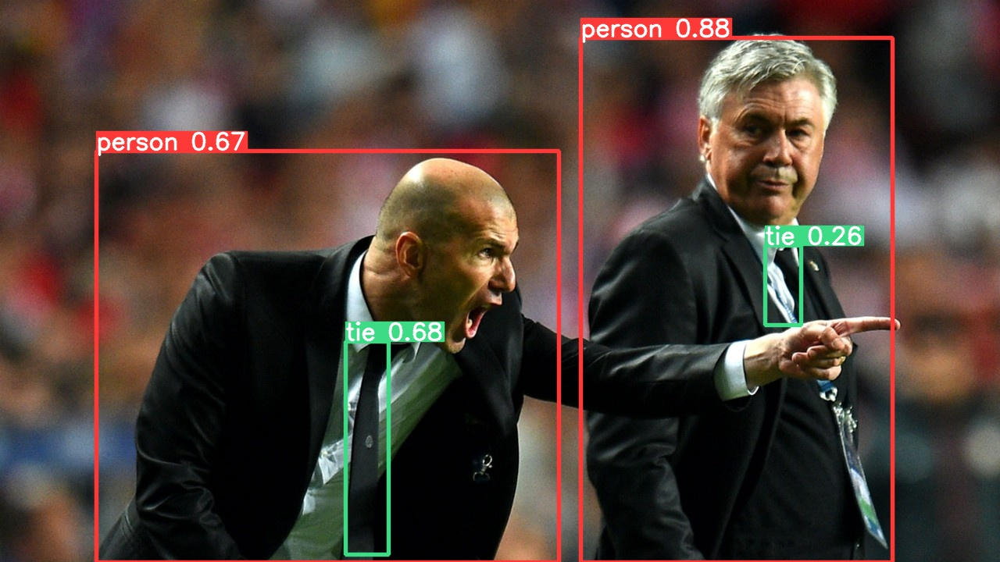

In [17]:
!python detect.py --weights yolov5s.pt --img 640 --conf 0.25 --source data/images/
Image(filename='runs/detect/exp/zidane.jpg', width=600)

# Fold 1

In [22]:
fold = 1
format_dataset_config(val_fold = fold)
!python train.py --epochs 50\
--img-size 640\
--batch-size 16\
--cfg models/yolov5s.yaml\
--weights yolov5s.pt\
--data /content/drive/MyDrive/ML-Task/koala.yaml\
--cache


Total Dataset:
  train: 266
  val: 133
  test: 30

yaml:
names:
- koala
nc: 1
train: /content/drive/MyDrive/ML-Task/train.txt/
val: /content/drive/MyDrive/ML-Task/val.txt/

2023-11-27 10:27:31.040839: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-11-27 10:27:31.040893: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-11-27 10:27:31.040929: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=models/yolov5s.yaml, data=/content/drive/MyDrive/ML-Task/koala.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=640, rect=False, res

In [23]:
glob('runs/train/**/*')

['runs/train/exp/weights',
 'runs/train/exp/hyp.yaml',
 'runs/train/exp/opt.yaml',
 'runs/train/exp/events.out.tfevents.1701080853.c902812500ad.2268.0',
 'runs/train/exp/labels_correlogram.jpg',
 'runs/train/exp/labels.jpg',
 'runs/train/exp/train_batch0.jpg',
 'runs/train/exp/train_batch1.jpg',
 'runs/train/exp/train_batch2.jpg',
 'runs/train/exp/results.csv',
 'runs/train/exp/val_batch0_pred.jpg',
 'runs/train/exp/val_batch0_labels.jpg',
 'runs/train/exp/val_batch1_pred.jpg',
 'runs/train/exp/val_batch1_labels.jpg',
 'runs/train/exp/val_batch2_labels.jpg',
 'runs/train/exp/val_batch2_pred.jpg',
 'runs/train/exp/F1_curve.png',
 'runs/train/exp/PR_curve.png',
 'runs/train/exp/P_curve.png',
 'runs/train/exp/R_curve.png',
 'runs/train/exp/confusion_matrix.png',
 'runs/train/exp/results.png']

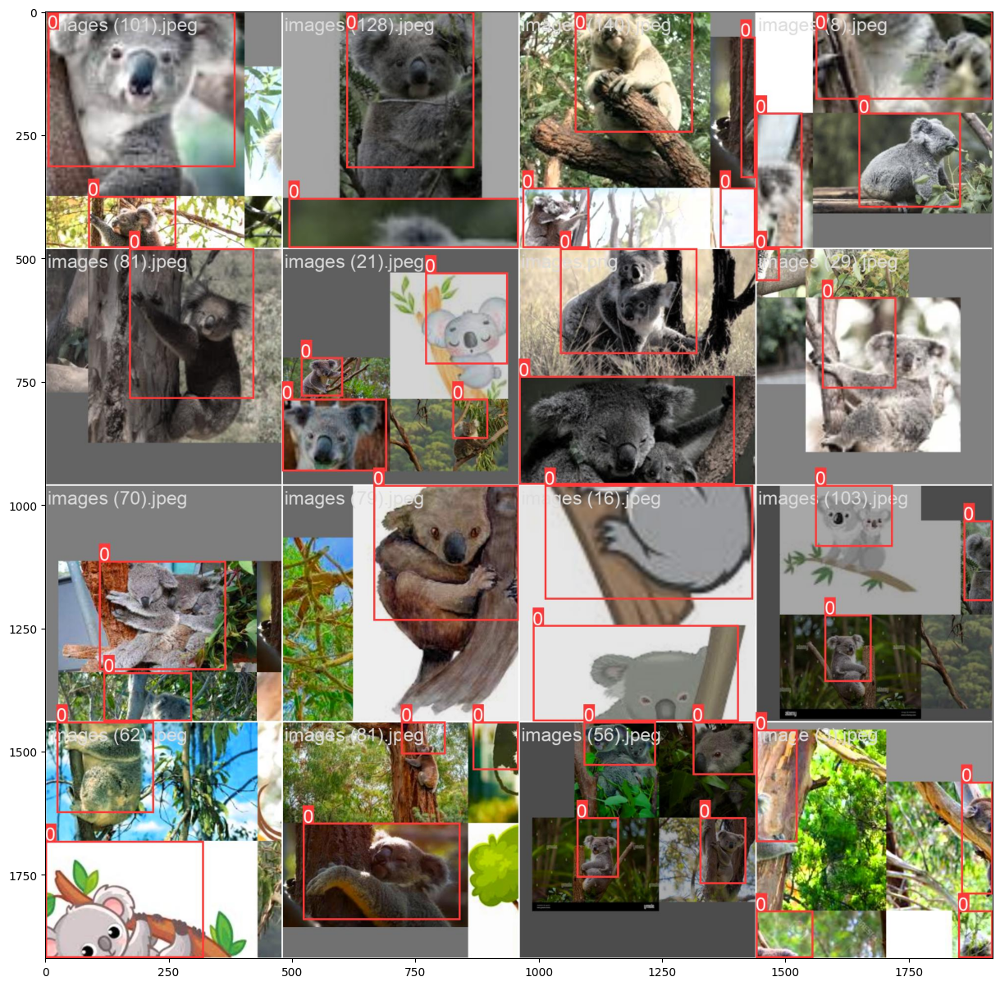

In [56]:
import matplotlib.pyplot as plt
plt.figure(figsize = (15, 15))
plt.imshow(cv2.cvtColor(cv2.imread("runs/train/exp/train_batch0.jpg"), cv2.COLOR_BGR2RGB))

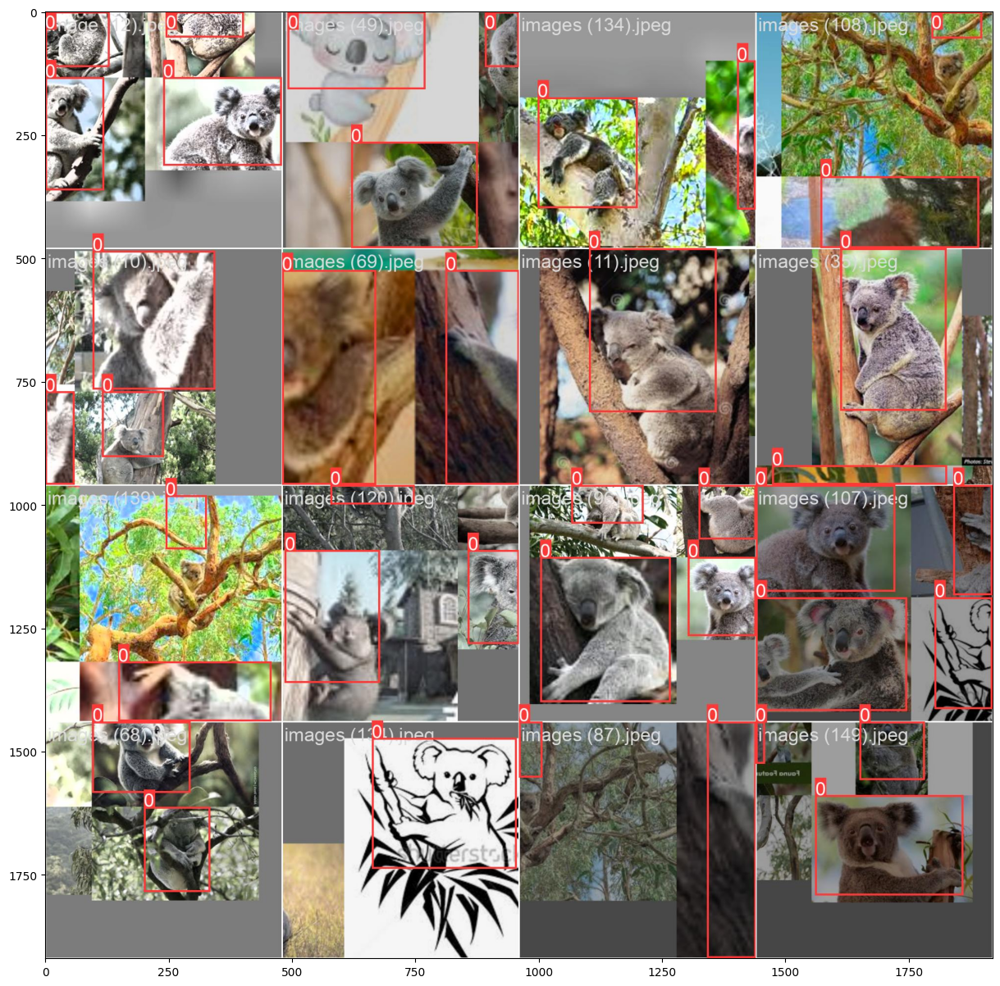

In [54]:
plt.figure(figsize = (15, 15))
plt.imshow(cv2.cvtColor(cv2.imread("runs/train/exp/train_batch1.jpg"), cv2.COLOR_BGR2RGB))

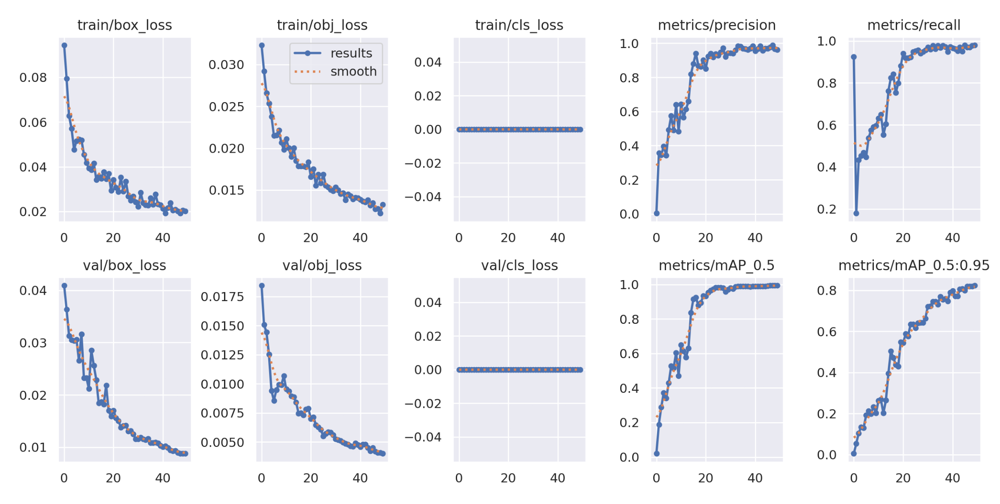

In [57]:
plt.figure(figsize=(30,15))
plt.axis('off')
plt.imshow(plt.imread('runs/train/exp/results.png'));

## Predicted Results

In [58]:
!python detect.py --source /content/drive/MyDrive/ML-Task/koala/images/test --weights /content/drive/MyDrive/ML-Task/yolov5/runs/train/exp/weights/best.pt --img-size 320 --conf 0.5 --save-conf --exist-ok

detect: weights=['/content/drive/MyDrive/ML-Task/yolov5/runs/train/exp/weights/best.pt'], source=/content/drive/MyDrive/ML-Task/koala/images/test, data=data/coco128.yaml, imgsz=[320, 320], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=True, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/30 /content/drive/MyDrive/ML-Task/koala/images/test/image (12).jpeg: 320x224 1 koala, 97.3ms
image 2/30 /content/drive/MyDrive/ML-Task/koala/images/test/image (3).jpeg: 192x320 1 koala, 70.7ms
image 3/30 /content/drive/MyDrive/ML-Task/koala/images/test/ima

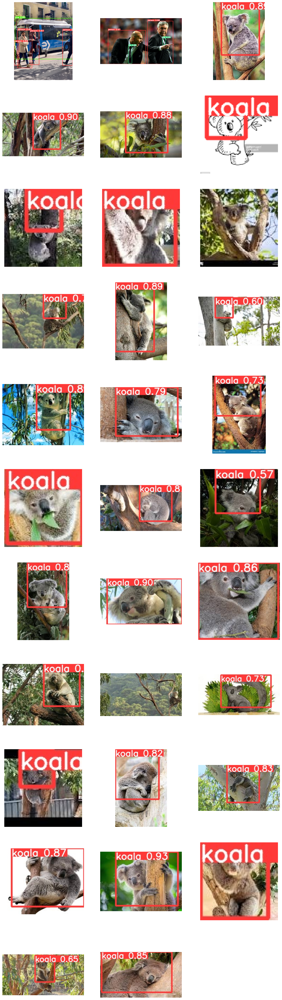

In [60]:
predict_images = glob("/content/drive/MyDrive/ML-Task/yolov5/runs/detect/exp/*")

num_images = len(predict_images)
num_columns = min(num_images, 3)  # You can adjust the number of columns as needed
num_rows = (num_images - 1) // num_columns + 1 # Calculate the number of rows required
plt.figure(figsize=(15, 5 * num_rows)) # Plot the images in a single row

for i, image in enumerate(predict_images, 1):
    plt.subplot(num_rows, num_columns, i)
    plt.imshow(cv2.cvtColor(cv2.imread(image),cv2.COLOR_BGR2RGB))
    plt.axis('off')

plt.show()

# Fold 2

In [62]:
fold = 2
format_dataset_config(val_fold = fold)
!python train.py --epochs 50\
--img-size 640\
--batch-size 16\
--cfg models/yolov5s.yaml\
--weights yolov5s.pt\
--data /content/drive/MyDrive/ML-Task/koala.yaml\
--cache


Total Dataset:
  train: 266
  val: 133
  test: 30

yaml:
names:
- koala
nc: 1
train: /content/drive/MyDrive/ML-Task/train.txt/
val: /content/drive/MyDrive/ML-Task/val.txt/

2023-11-27 11:03:23.600173: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-11-27 11:03:23.600236: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-11-27 11:03:23.600277: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=models/yolov5s.yaml, data=/content/drive/MyDrive/ML-Task/koala.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=640, rect=False, res

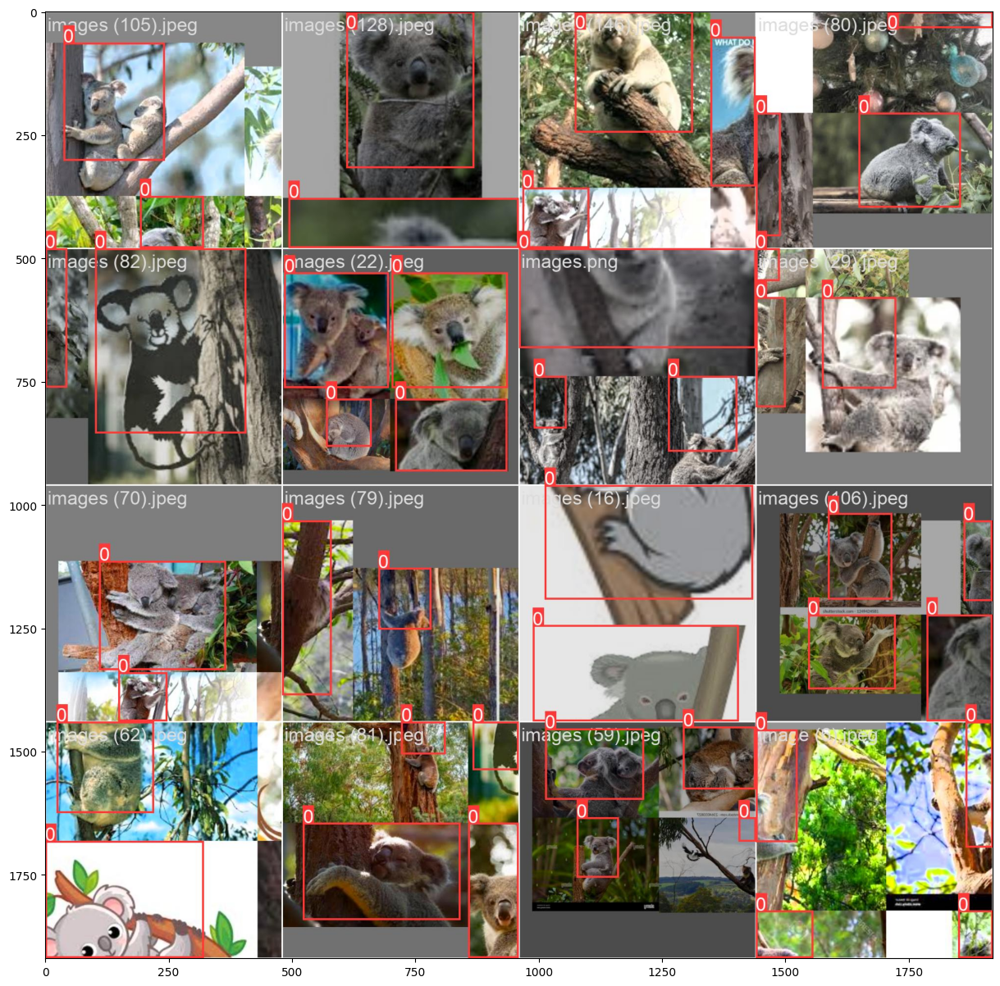

In [65]:
import matplotlib.pyplot as plt
plt.figure(figsize = (15, 15))
plt.imshow(cv2.cvtColor(cv2.imread("runs/train/exp2/train_batch0.jpg"), cv2.COLOR_BGR2RGB))

In [67]:
!python detect.py --source /content/drive/MyDrive/ML-Task/koala/images/test --weights /content/drive/MyDrive/ML-Task/yolov5/runs/train/exp2/weights/best.pt --img-size 320 --conf 0.5 --save-conf --exist-ok

detect: weights=['/content/drive/MyDrive/ML-Task/yolov5/runs/train/exp2/weights/best.pt'], source=/content/drive/MyDrive/ML-Task/koala/images/test, data=data/coco128.yaml, imgsz=[320, 320], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=True, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/30 /content/drive/MyDrive/ML-Task/koala/images/test/image (12).jpeg: 320x224 1 koala, 65.9ms
image 2/30 /content/drive/MyDrive/ML-Task/koala/images/test/image (3).jpeg: 192x320 1 koala, 41.2ms
image 3/30 /content/drive/MyDrive/ML-Task/koala/images/test/im

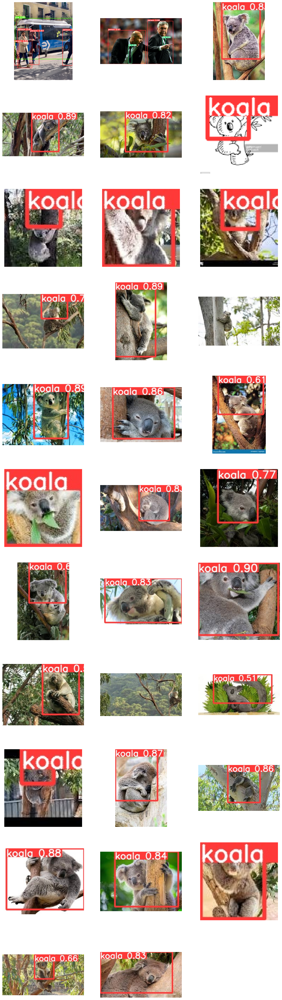

In [69]:
predict_images = glob("/content/drive/MyDrive/ML-Task/yolov5/runs/detect/exp/*")

num_images = len(predict_images)
num_columns = min(num_images, 3)  # You can adjust the number of columns as needed
num_rows = (num_images - 1) // num_columns + 1 # Calculate the number of rows required
plt.figure(figsize=(15, 5 * num_rows)) # Plot the images in a single row

for i, image in enumerate(predict_images, 1):
    plt.subplot(num_rows, num_columns, i)
    plt.imshow(cv2.cvtColor(cv2.imread(image),cv2.COLOR_BGR2RGB))
    plt.axis('off')

plt.show()

## Fold 3



In [71]:
fold = 3
format_dataset_config(val_fold = fold)
!python train.py --epochs 50\
--img-size 220\
--batch-size 16\
--cfg models/yolov5s.yaml\
--weights yolov5s.pt\
--data /content/drive/MyDrive/ML-Task/koala.yaml\
--cache


Total Dataset:
  train: 266
  val: 133
  test: 30

yaml:
names:
- koala
nc: 1
train: /content/drive/MyDrive/ML-Task/train.txt/
val: /content/drive/MyDrive/ML-Task/val.txt/

2023-11-27 11:14:40.301773: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-11-27 11:14:40.301832: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-11-27 11:14:40.301867: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=models/yolov5s.yaml, data=/content/drive/MyDrive/ML-Task/koala.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=220, rect=False, res

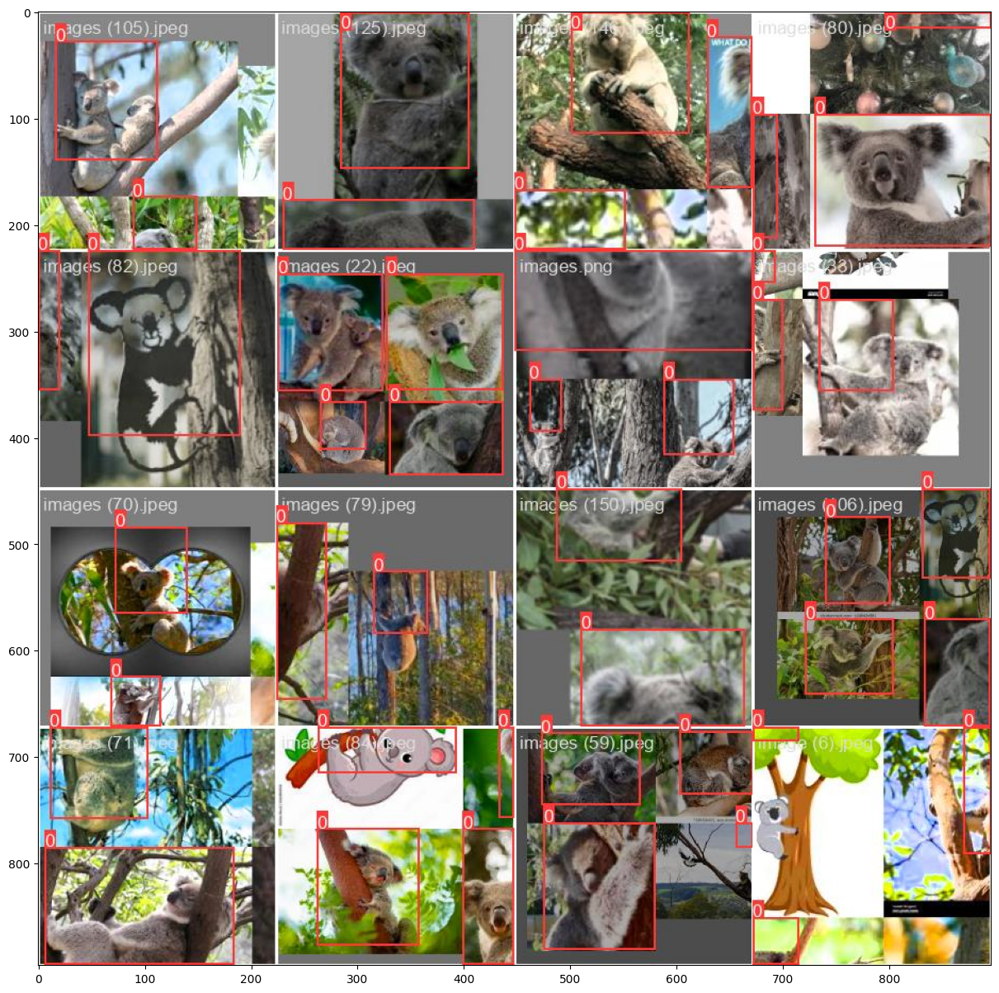

In [72]:
import matplotlib.pyplot as plt
plt.figure(figsize = (15, 15))
plt.imshow(cv2.cvtColor(cv2.imread("runs/train/exp3/train_batch0.jpg"), cv2.COLOR_BGR2RGB))

In [73]:
!python detect.py --source /content/drive/MyDrive/ML-Task/koala/images/test --weights /content/drive/MyDrive/ML-Task/yolov5/runs/train/exp2/weights/best.pt --img-size 320 --conf 0.5 --save-conf --exist-ok

detect: weights=['/content/drive/MyDrive/ML-Task/yolov5/runs/train/exp2/weights/best.pt'], source=/content/drive/MyDrive/ML-Task/koala/images/test, data=data/coco128.yaml, imgsz=[320, 320], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=True, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/30 /content/drive/MyDrive/ML-Task/koala/images/test/image (12).jpeg: 320x224 1 koala, 67.6ms
image 2/30 /content/drive/MyDrive/ML-Task/koala/images/test/image (3).jpeg: 192x320 1 koala, 67.7ms
image 3/30 /content/drive/MyDrive/ML-Task/koala/images/test/im

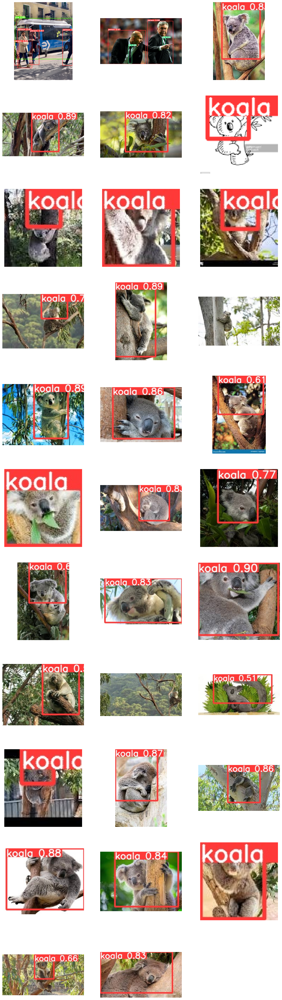

In [74]:
predict_images = glob("/content/drive/MyDrive/ML-Task/yolov5/runs/detect/exp/*")

num_images = len(predict_images)
num_columns = min(num_images, 3)  # You can adjust the number of columns as needed
num_rows = (num_images - 1) // num_columns + 1 # Calculate the number of rows required
plt.figure(figsize=(15, 5 * num_rows)) # Plot the images in a single row

for i, image in enumerate(predict_images, 1):
    plt.subplot(num_rows, num_columns, i)
    plt.imshow(cv2.cvtColor(cv2.imread(image),cv2.COLOR_BGR2RGB))
    plt.axis('off')

plt.show()

## Load Weight with Model

YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


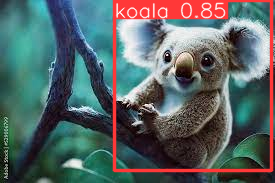

In [80]:
import torch
model = torch.hub.load('.', 'custom', path='/content/drive/MyDrive/ML-Task/yolov5/runs/train/exp2/weights/best.pt', source='local')
img = cv2.imread('/content/drive/MyDrive/ML-Task/images/fold1/images (110).jpeg')
results = model(img)
results.show()